In [1]:
# for ease of experimentation
%load_ext autoreload
%autoreload 2

In [2]:
import PIL
import matplotlib.pyplot as plt
import numpy as np
import requests
import shutil
import os
import torch
import torchvision
from PIL.Image import Image

# from model.dataloader import ImageDataLoader, ImageSketchDataLoader
# from  import GumbelVQ
from omegaconf import OmegaConf
import yaml
import torchvision.transforms.functional as TF
import torchvision.transforms as T
import sys

sys.path.insert(0, './taming-transformers')
from taming.models.vqgan import VQModel
import torchaudio
import torchaudio.transforms as T_audio
from data import MuseDB_HQ
from yaml import load, dump
from IPython.display import Audio

try:
    from yaml import CLoader as Loader, CDumper as Dumper
except ImportError:
    from yaml import Loader, Dumper

In [3]:
dataset = MuseDB_HQ('./dataset/MUSDBhq/test')

Found 250 images


In [16]:
dataset.wav_paths[2]

'./dataset/MUSDBhq/test\\AM Contra - Heart Peripheral\\mixture.wav'

In [5]:
args = """
embed_dim: 256
n_embed: 1024
ddconfig:
  double_z: False
  z_channels: 256
  resolution: 256
  in_channels: 2
  out_ch: 2
  ch: 128
  ch_mult: [ 1,1,2,2,4]  # num_down = len(ch_mult)-1
  num_res_blocks: 2
  attn_resolutions: [16]
  dropout: 0.0


lossconfig:
  target: taming.modules.losses.vqperceptual.VQLPIPSWithDiscriminator
  params:
    disc_conditional: False
    disc_in_channels: 2
    disc_start: 10000
    disc_weight: 0.8
    codebook_weight: 1.0
"""
args = yaml.load(args, Loader=Loader)
# args
vae = VQModel(**args)
inp = dataset[0]['spectogram'][:, :, :].reshape(1, 2, 256, -1)  #, 0)
print('INPUT SHAPE:', inp.shape)
pred = vae.forward(inp)

Working with z of shape (1, 256, 16, 16) = 65536 dimensions.


C:\Users\felix\AppData\Local\Programs\Python\Python39\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
C:\Users\felix\AppData\Local\Programs\Python\Python39\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


loaded pretrained LPIPS loss from taming/modules/autoencoder/lpips\vgg.pth
VQLPIPSWithDiscriminator running with hinge loss.
INPUT SHAPE: torch.Size([1, 2, 256, 3283])


In [4]:
import matplotlib.pyplot as plt
import librosa
import librosa.display
from torchaudio.transforms import Resample, Spectrogram, TimeMasking, TimeStretch, FrequencyMasking, MelScale, InverseMelScale, InverseSpectrogram

In [5]:
def plot_spectrogram(specgram, title=None, ylabel="freq_bin"):
    fig, axs = plt.subplots(1, 1)
    axs.set_title(title or "Spectrogram (db)")
    axs.set_ylabel(ylabel)
    axs.set_xlabel("frame")
    im = axs.imshow(librosa.power_to_db(specgram), origin="lower", aspect="auto")
    fig.colorbar(im, ax=axs)
    plt.show(block=False)

In [6]:
inp = dataset[2]['spectogram'][0, :, :]
wav = dataset[2]['wav']
inp.shape, wav.shape

(torch.Size([513, 9849]), torch.Size([2, 5042539]))

In [28]:
# torch.view_as_real(inp)[:, :, 0].shape
cat_spec = torch.view_as_real(dataset[2]['spectogram']).reshape([4, 513, -1])
print(cat_spec.shape)
rec_left = cat_spec[[2, 3], :, :].view(513, -1, 2)
print(rec_left.shape)
left = torch.view_as_complex(rec_left)
left.shape

torch.Size([4, 513, 9849])
torch.Size([513, 9849, 2])


torch.Size([513, 9849])

In [30]:
delta_left = dataset[2]['spectogram'][1, :, :] - left
torch.sum(delta_left)

tensor(0.+0.j)

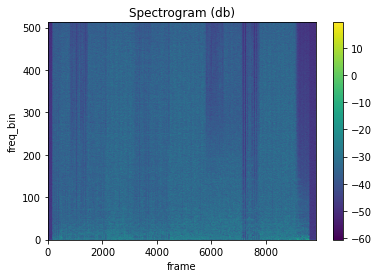

In [14]:
plot_spectrogram(torch.view_as_real(inp)[:, :, 0])

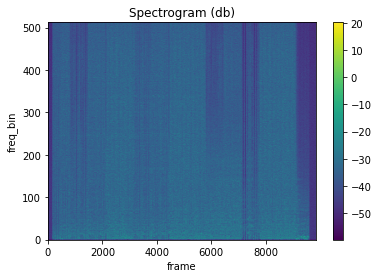

In [15]:
plot_spectrogram(torch.view_as_real(inp)[:, :, 1])

C:\Users\felix\AppData\Local\Programs\Python\Python39\lib\site-packages\librosa\util\decorators.py:88: UserWarning: power_to_db was called on complex input so phase information will be discarded. To suppress this warning, call power_to_db(np.abs(D)**2) instead.
  return f(*args, **kwargs)


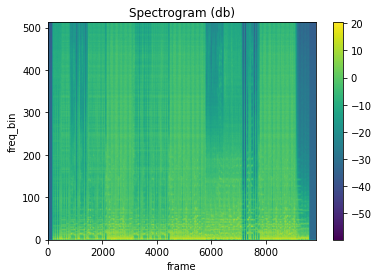

In [16]:
plot_spectrogram(inp)

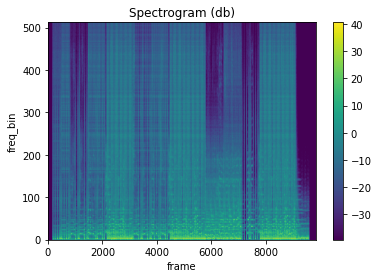

In [12]:
plot_spectrogram(torch.view_as_real(inp)[:, :, 0])
Audio(wav, rate=24_000)

In [7]:
# spectogram to wav
n_fft = 1024
n_mel = 256
n_mels = n_mel
n_stft = n_fft // 2 + 1
print('1')

# inverse_mel_pred = torchaudio.transforms.InverseMelScale(sample_rate=8000, n_stft=n_stft, n_mels=n_mels)(inp)
# print('2')
pred_audio = torchaudio.transforms.InverseSpectrogram(n_fft=n_fft)(inp)
# pred_audio = torchaudio.transforms.GriffinLim(n_fft=n_fft)(inp)
print('3')

1


ValueError: Expected `spectrogram` to be complex dtype.

In [9]:
Audio(pred_audio, rate=24_000)

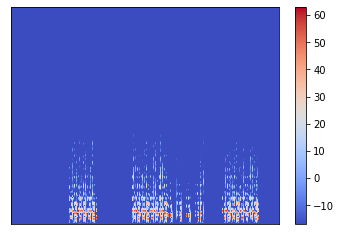

In [19]:
# fig, ax = plt.subplots(2, 2)
# ax[0][0].set_title('OG - left')
# ax[0][0].imshow(inp[0][0])
# ax[0][0].pcolormesh(0, 8000, inp[0][0], shading='auto')
plt.figure()
log_spectro = librosa.amplitude_to_db(inp[0][0])

librosa.display.specshow(log_spectro)
plt.colorbar()

[]

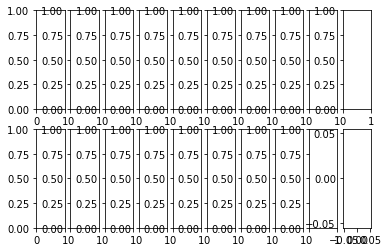

[]

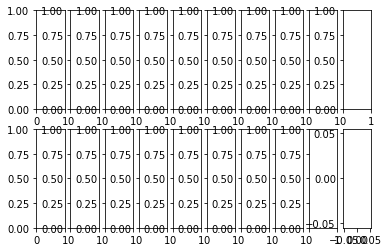

In [33]:
fig, ax = plt.subplots(2, 10)
plt.plot()